# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on the Celeb A dataset which is a large set of celebrity face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). 

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator

# Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

In [7]:
batch_size = 128
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [8]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

In [17]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

NameError: name 'show_images' is not defined

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [9]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0002

### Train GAN

In [19]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [20]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.416, G:2.536


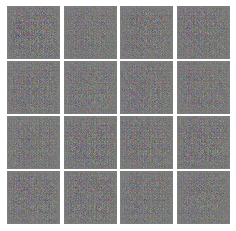


Iter: 250, D: 0.4787, G:4.34


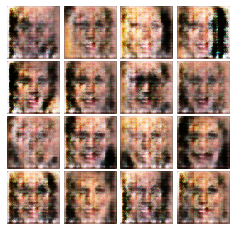


Iter: 500, D: 1.58, G:6.862


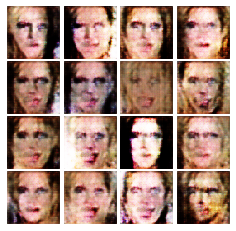


Iter: 750, D: 0.9423, G:3.311


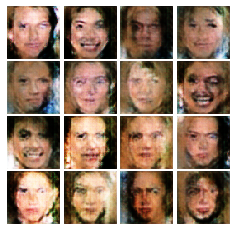


EPOCH:  2
Iter: 1000, D: 0.845, G:3.311


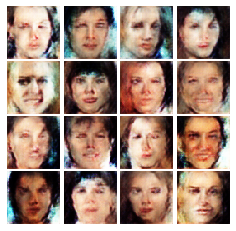


Iter: 1250, D: 0.7606, G:1.942


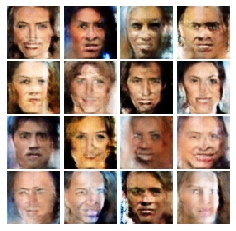


Iter: 1500, D: 0.8803, G:1.819


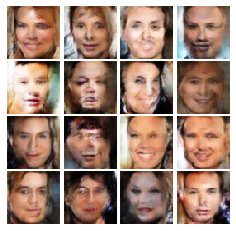


Iter: 1750, D: 0.7251, G:2.14


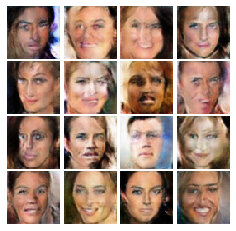


EPOCH:  3
Iter: 2000, D: 0.8007, G:2.645


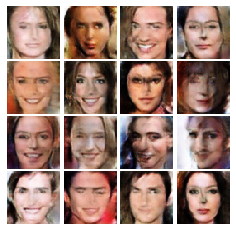


Iter: 2250, D: 0.8102, G:2.032


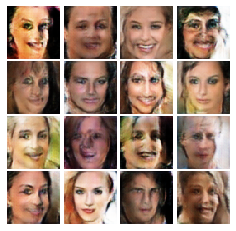


Iter: 2500, D: 0.855, G:2.331


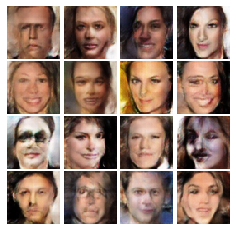


Iter: 2750, D: 0.8499, G:3.54


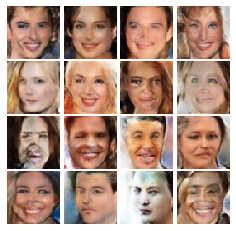


EPOCH:  4
Iter: 3000, D: 1.143, G:4.417


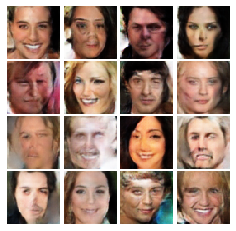


Iter: 3250, D: 0.7637, G:1.158


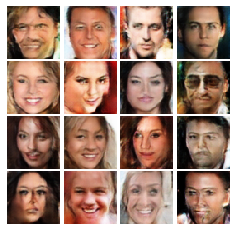


Iter: 3500, D: 0.8304, G:3.236


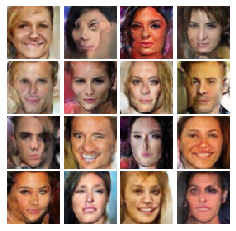


Iter: 3750, D: 0.6054, G:0.9351


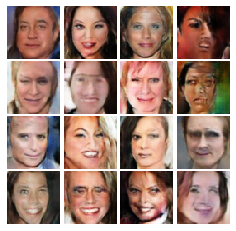


EPOCH:  5
Iter: 4000, D: 0.3788, G:2.771


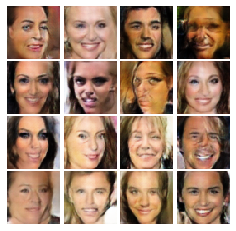


Iter: 4250, D: 0.453, G:2.42


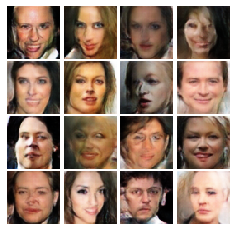


Iter: 4500, D: 0.5543, G:2.425


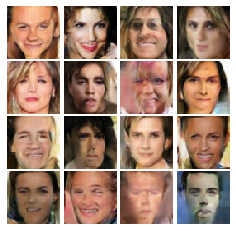


Iter: 4750, D: 0.5406, G:2.715


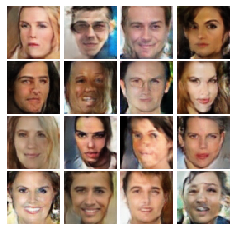


EPOCH:  6
Iter: 5000, D: 0.4111, G:2.431


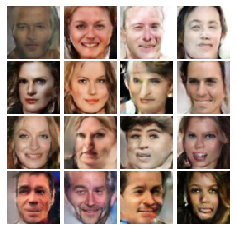


Iter: 5250, D: 0.7917, G:4.213


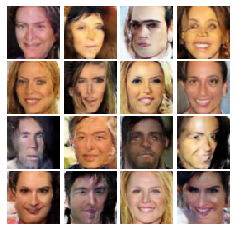


Iter: 5500, D: 0.5537, G:1.291


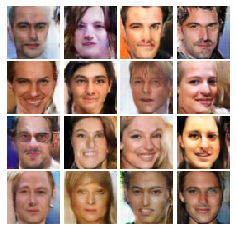


Iter: 5750, D: 0.6268, G:1.17


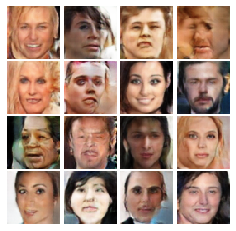


EPOCH:  7
Iter: 6000, D: 0.4189, G:2.717


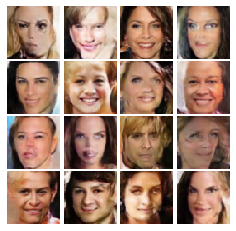


Iter: 6250, D: 0.43, G:2.201


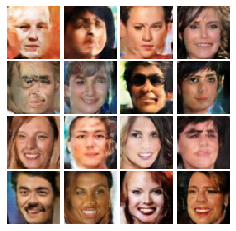


Iter: 6500, D: 0.4021, G:2.247


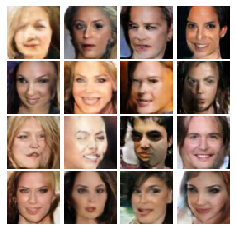


Iter: 6750, D: 0.4113, G:2.796


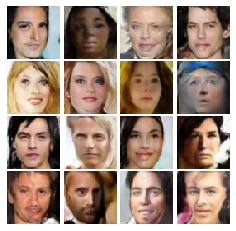


EPOCH:  8
Iter: 7000, D: 0.384, G:3.34


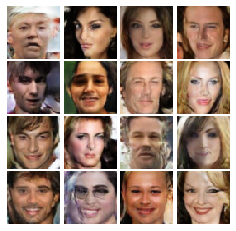


Iter: 7250, D: 0.369, G:3.559


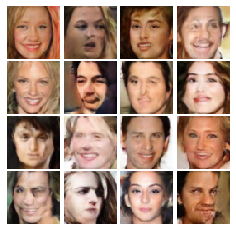


Iter: 7500, D: 0.2989, G:2.2


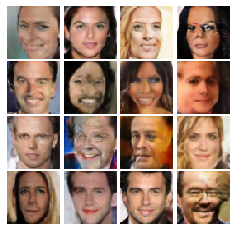


Iter: 7750, D: 0.5282, G:3.533


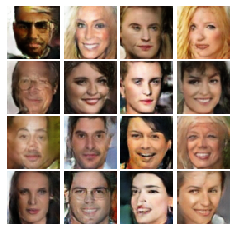


EPOCH:  9
Iter: 8000, D: 0.3407, G:2.196


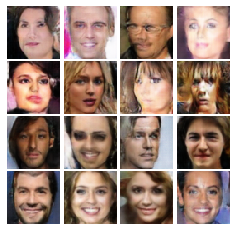


Iter: 8250, D: 0.5172, G:4.884


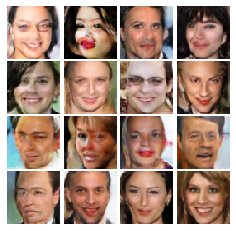


Iter: 8500, D: 0.2102, G:2.35


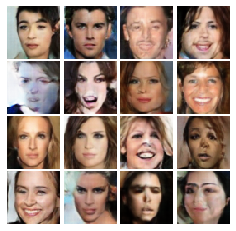


Iter: 8750, D: 0.3161, G:2.345


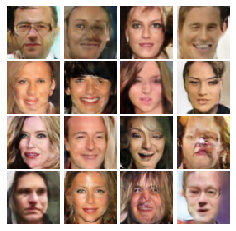


EPOCH:  10
Iter: 9000, D: 0.6535, G:1.327


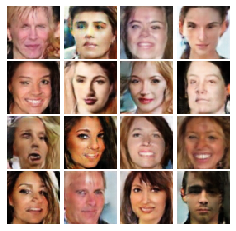


Iter: 9250, D: 0.1945, G:4.206


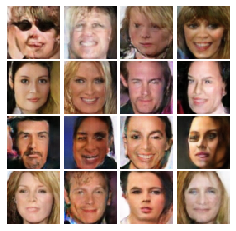


Iter: 9500, D: 0.4202, G:2.447


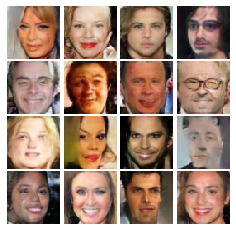


Iter: 9750, D: 0.3769, G:2.783


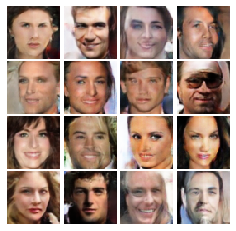


EPOCH:  11
Iter: 10000, D: 0.3103, G:2.036


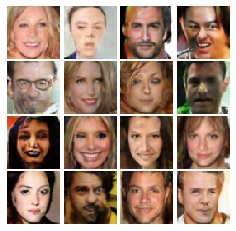


Iter: 10250, D: 0.1727, G:2.632


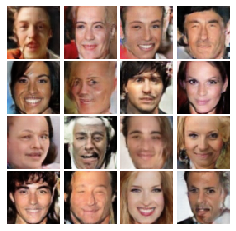


Iter: 10500, D: 0.3411, G:3.24


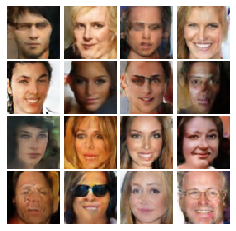


Iter: 10750, D: 2.808, G:9.731


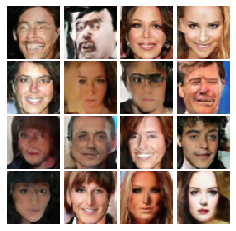


EPOCH:  12
Iter: 11000, D: 0.4708, G:5.808


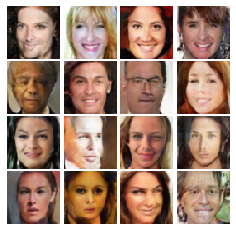


Iter: 11250, D: 0.3648, G:2.0


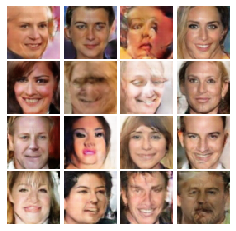


Iter: 11500, D: 0.5501, G:3.89


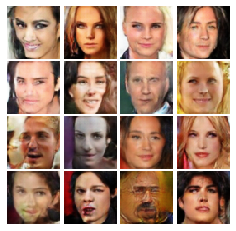


Iter: 11750, D: 0.3505, G:3.793


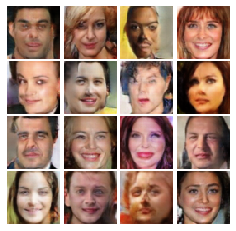


EPOCH:  13
Iter: 12000, D: 0.4711, G:1.896


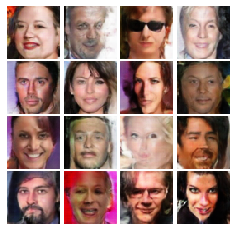


Iter: 12250, D: 0.06576, G:3.392


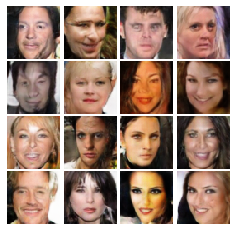


Iter: 12500, D: 0.1156, G:3.857


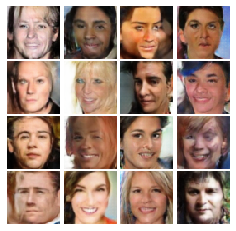


Iter: 12750, D: 0.9905, G:3.47


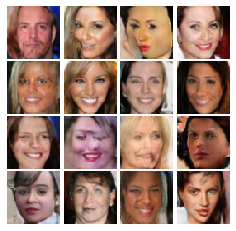


EPOCH:  14
Iter: 13000, D: 0.1342, G:4.335


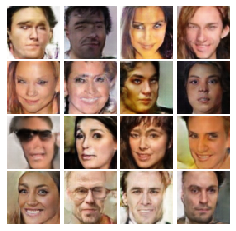


Iter: 13250, D: 0.2478, G:3.196


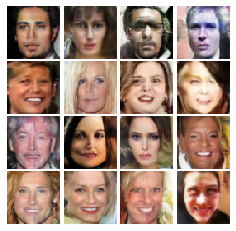


Iter: 13500, D: 0.2304, G:3.127


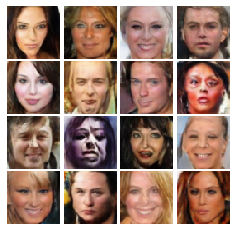


Iter: 13750, D: 0.6335, G:3.088


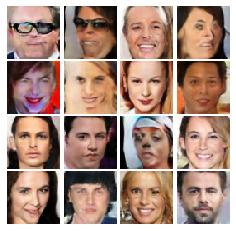


EPOCH:  15
Iter: 14000, D: 0.1069, G:4.29


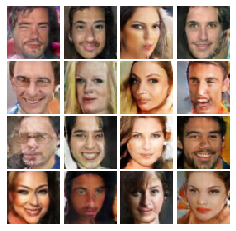


Iter: 14250, D: 0.2903, G:2.892


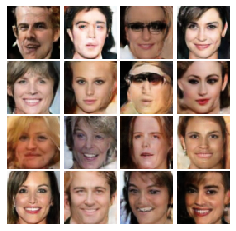


Iter: 14500, D: 0.4345, G:5.596


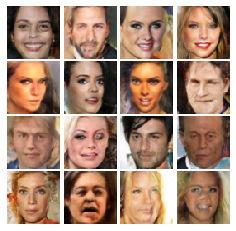


Iter: 14750, D: 0.08274, G:4.013


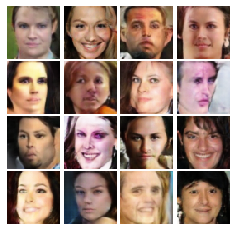


EPOCH:  16
Iter: 15000, D: 0.05671, G:5.381


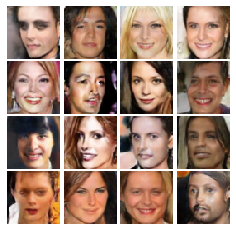


Iter: 15250, D: 0.391, G:3.841


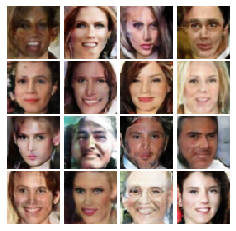


Iter: 15500, D: 0.1345, G:4.328


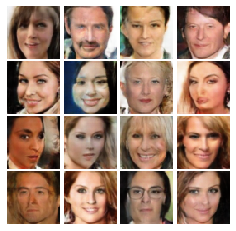


Iter: 15750, D: 0.3836, G:3.41


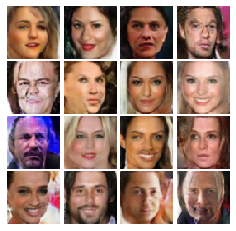


EPOCH:  17
Iter: 16000, D: 0.1641, G:3.565


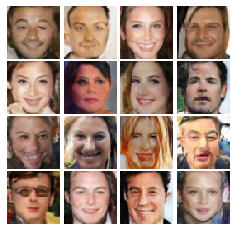


Iter: 16250, D: 0.2246, G:2.652


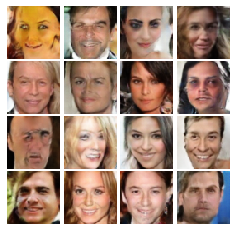


Iter: 16500, D: 0.3208, G:6.282


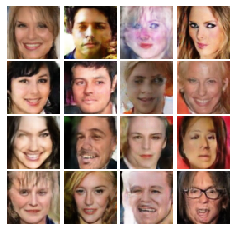


Iter: 16750, D: 0.08095, G:3.475


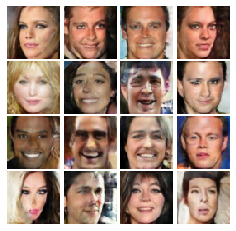


EPOCH:  18
Iter: 17000, D: 0.02491, G:5.74


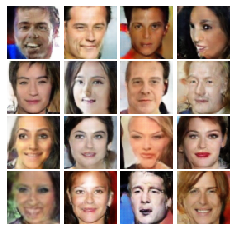


Iter: 17250, D: 0.8022, G:4.865


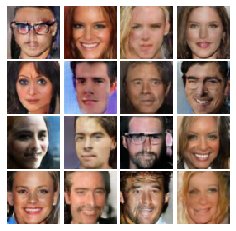


Iter: 17500, D: 4.154, G:0.1528


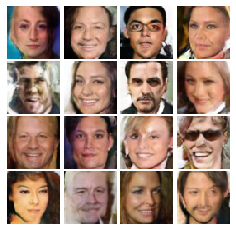


EPOCH:  19
Iter: 17750, D: 0.3376, G:2.526


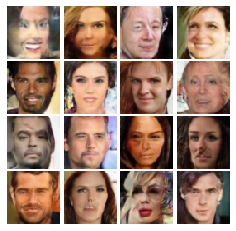


Iter: 18000, D: 0.22, G:3.014


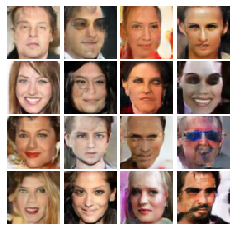


Iter: 18250, D: 0.1349, G:4.484


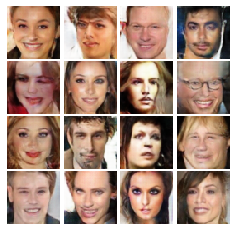


Iter: 18500, D: 0.03585, G:4.332


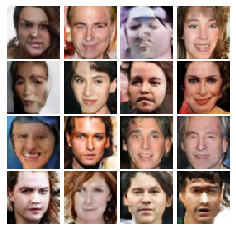


EPOCH:  20
Iter: 18750, D: 0.2482, G:4.612


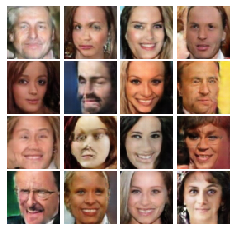


Iter: 19000, D: 0.08859, G:4.489


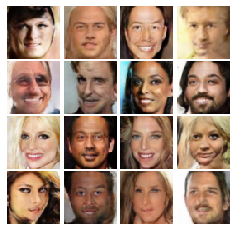


Iter: 19250, D: 0.1076, G:3.83


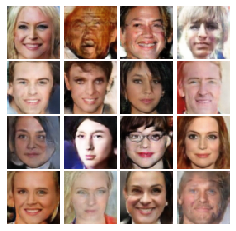


Iter: 19500, D: 0.2949, G:2.19


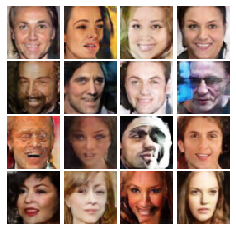


EPOCH:  21


KeyboardInterrupt: 

In [21]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          train_loader=celeba_loader_train, device=device)


### Train LS-GAN

In [10]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [11]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.3349, G:0.06685


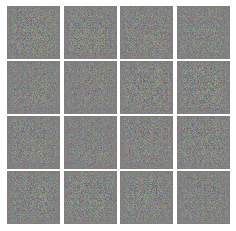


Iter: 200, D: 0.1683, G:0.6354


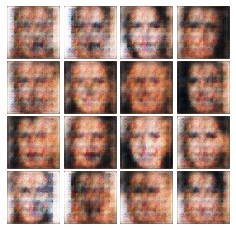


Iter: 400, D: 0.1772, G:0.7224


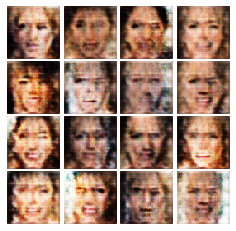


Iter: 600, D: 0.1957, G:0.7347


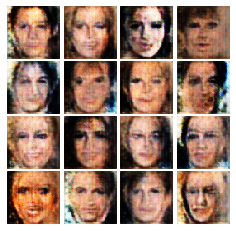


Iter: 800, D: 0.1901, G:0.7941


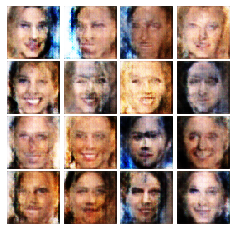


EPOCH:  2
Iter: 1000, D: 0.1723, G:1.003


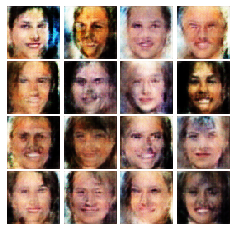


Iter: 1200, D: 0.1778, G:0.442


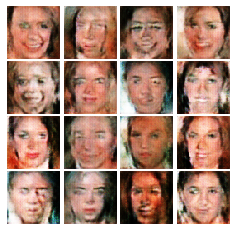


Iter: 1400, D: 0.1971, G:0.8635


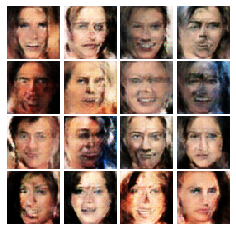


Iter: 1600, D: 0.2173, G:1.115


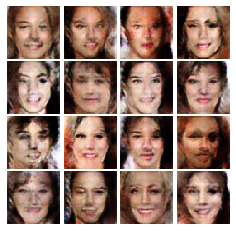


Iter: 1800, D: 0.185, G:0.821


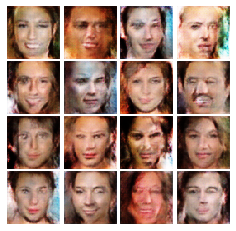


EPOCH:  3
Iter: 2000, D: 0.1894, G:1.045


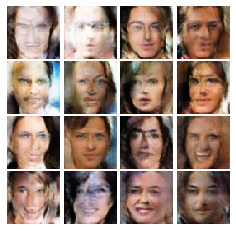


Iter: 2200, D: 0.1551, G:0.7199


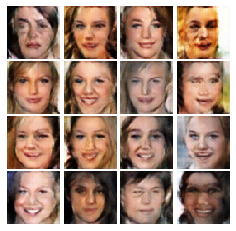


Iter: 2400, D: 0.1991, G:0.5866


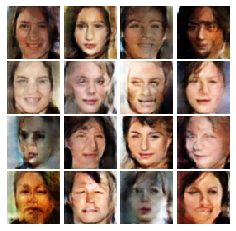


Iter: 2600, D: 0.1342, G:1.012


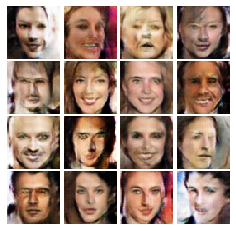


Iter: 2800, D: 0.2259, G:0.326


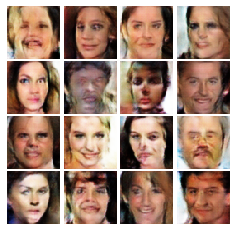


EPOCH:  4
Iter: 3000, D: 0.1825, G:0.4833


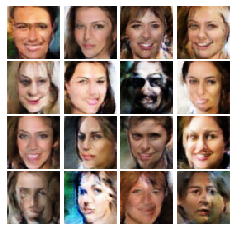


Iter: 3200, D: 0.1571, G:0.54


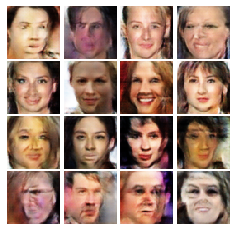


Iter: 3400, D: 0.2172, G:0.4427


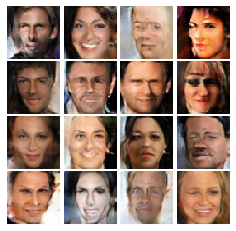


Iter: 3600, D: 0.1908, G:0.3176


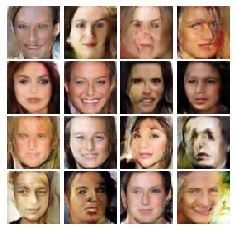


Iter: 3800, D: 0.1838, G:0.5014


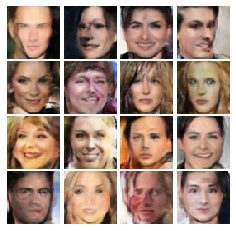


EPOCH:  5
Iter: 4000, D: 0.1333, G:0.7292


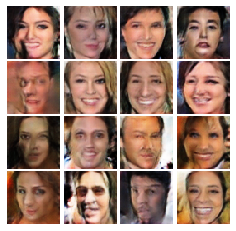


Iter: 4200, D: 0.1269, G:0.6116


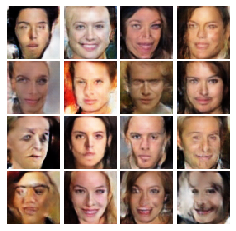


Iter: 4400, D: 0.126, G:0.848


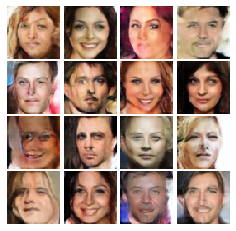


Iter: 4600, D: 0.1263, G:0.5346


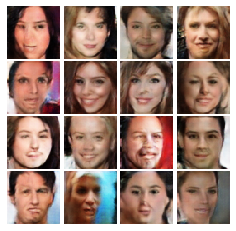


Iter: 4800, D: 0.09554, G:0.5722


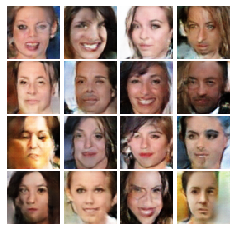


EPOCH:  6
Iter: 5000, D: 0.1098, G:0.7504


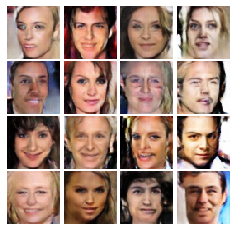


Iter: 5200, D: 0.09571, G:0.8343


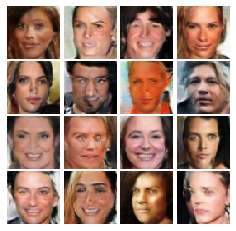


Iter: 5400, D: 0.1696, G:1.266


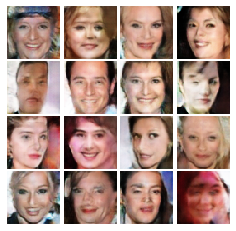


Iter: 5600, D: 0.1321, G:0.6338


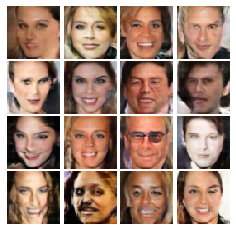


Iter: 5800, D: 0.09862, G:0.9638


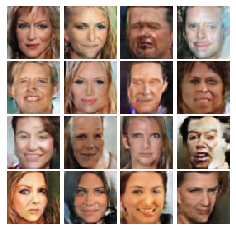


EPOCH:  7
Iter: 6000, D: 0.1142, G:0.745


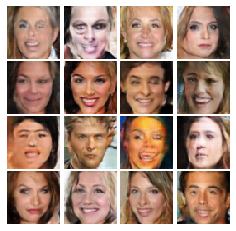


Iter: 6200, D: 0.1018, G:0.9673


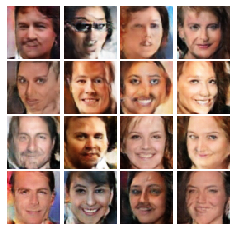


Iter: 6400, D: 0.3863, G:1.824


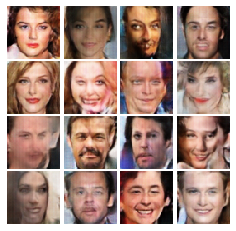


Iter: 6600, D: 0.1737, G:0.4223


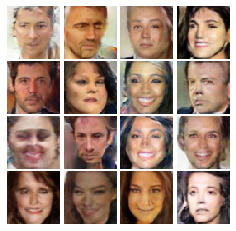


Iter: 6800, D: 0.1151, G:0.7355


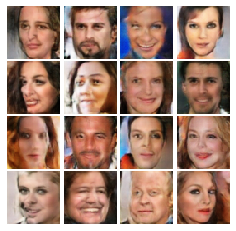


EPOCH:  8
Iter: 7000, D: 0.2108, G:0.2505


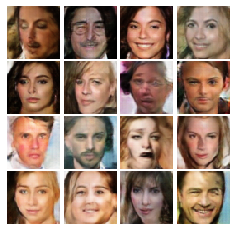


Iter: 7200, D: 0.1469, G:0.7327


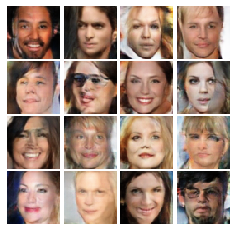


Iter: 7400, D: 0.08398, G:0.7307


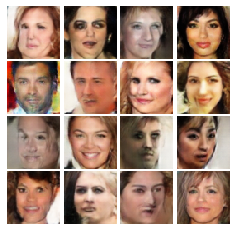


Iter: 7600, D: 0.08784, G:0.7939


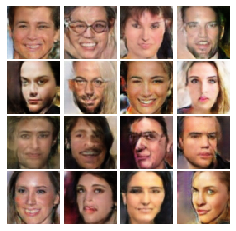


Iter: 7800, D: 0.1161, G:0.8062


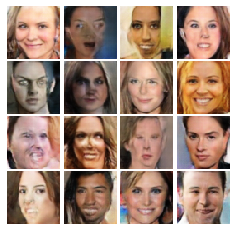


EPOCH:  9
Iter: 8000, D: 0.1354, G:1.135


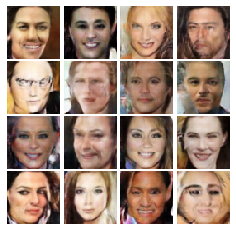


Iter: 8200, D: 0.1143, G:1.067


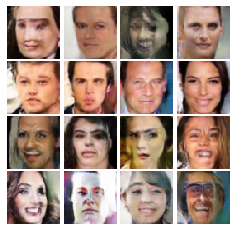


Iter: 8400, D: 0.1357, G:0.6574


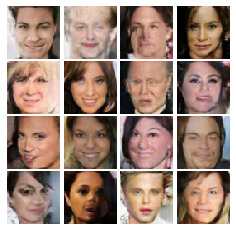


Iter: 8600, D: 0.443, G:0.4461


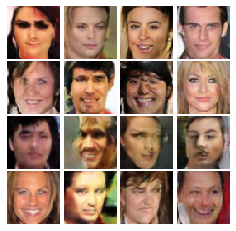


Iter: 8800, D: 0.1423, G:1.457


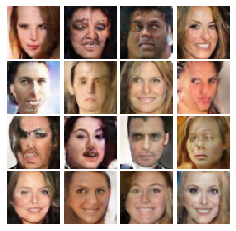


EPOCH:  10
Iter: 9000, D: 0.1592, G:1.894


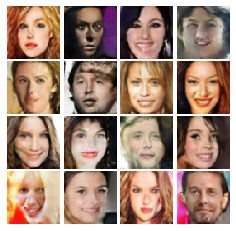


Iter: 9200, D: 0.07871, G:0.8602


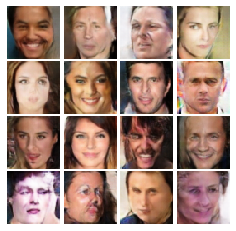


Iter: 9400, D: 0.07687, G:1.251


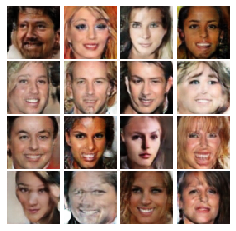


Iter: 9600, D: 0.08001, G:0.5426


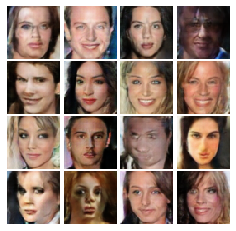


Iter: 9800, D: 0.04206, G:1.078


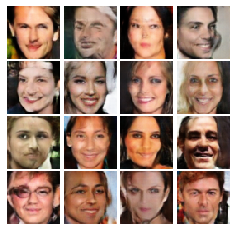


EPOCH:  11
Iter: 10000, D: 0.1018, G:0.5345


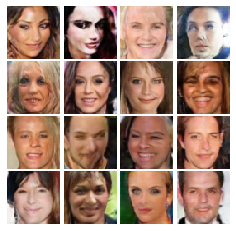


Iter: 10200, D: 0.08953, G:1.265


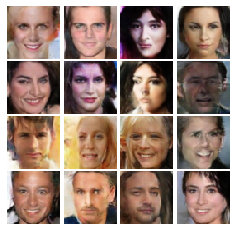


Iter: 10400, D: 0.09827, G:0.9316


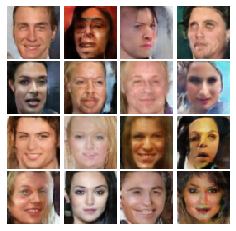


Iter: 10600, D: 0.1903, G:1.305


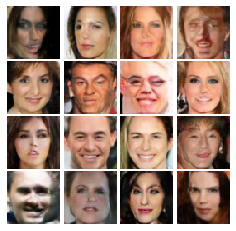


Iter: 10800, D: 0.07099, G:0.6876


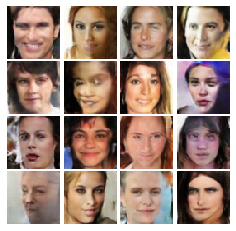


EPOCH:  12
Iter: 11000, D: 0.129, G:0.9091


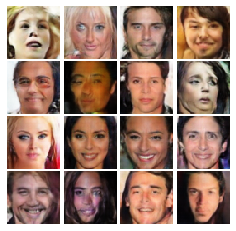


Iter: 11200, D: 0.2461, G:2.05


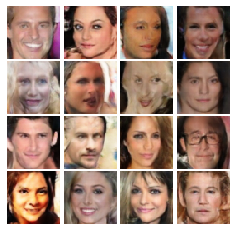


Iter: 11400, D: 0.1899, G:1.439


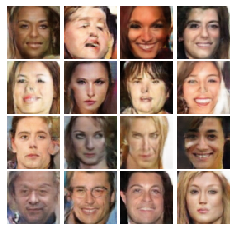


Iter: 11600, D: 0.09623, G:0.7189


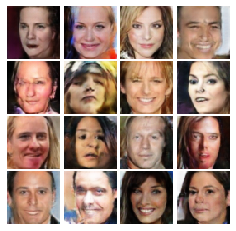


Iter: 11800, D: 0.08194, G:0.543


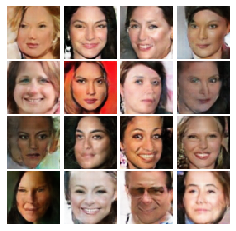


EPOCH:  13
Iter: 12000, D: 0.06982, G:0.8228


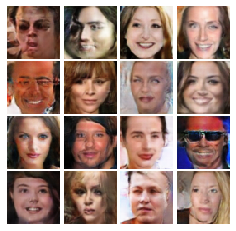


Iter: 12200, D: 0.05941, G:0.7305


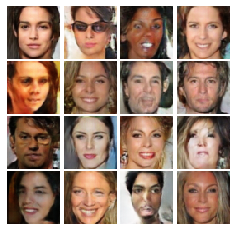


Iter: 12400, D: 0.1273, G:1.053


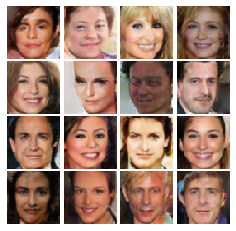


Iter: 12600, D: 0.05859, G:0.7942


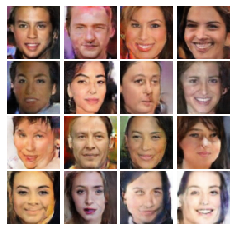


Iter: 12800, D: 0.05597, G:0.8499


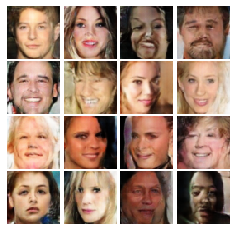


EPOCH:  14
Iter: 13000, D: 0.07481, G:0.9253


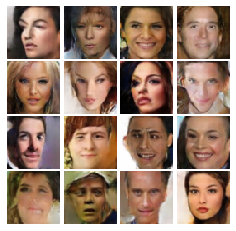


Iter: 13200, D: 0.04305, G:1.018


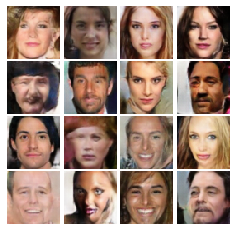


Iter: 13400, D: 0.1043, G:1.115


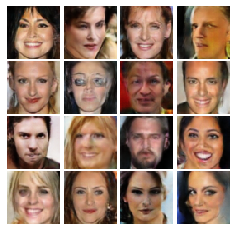


Iter: 13600, D: 0.05969, G:0.5393


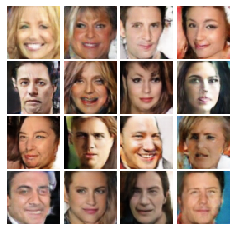


Iter: 13800, D: 0.136, G:0.398


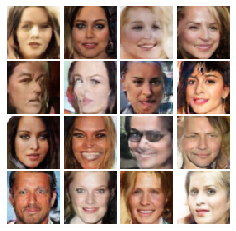


EPOCH:  15
Iter: 14000, D: 0.08214, G:0.9124


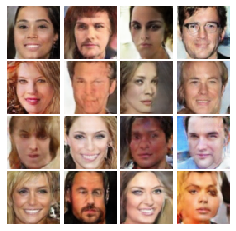


Iter: 14200, D: 0.3193, G:0.1496


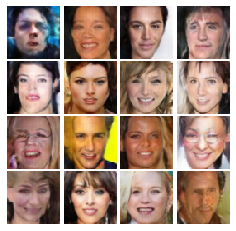


Iter: 14400, D: 0.1094, G:0.5691


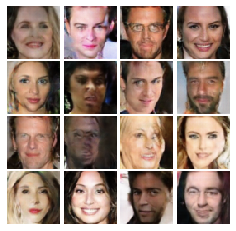


Iter: 14600, D: 0.08612, G:1.032


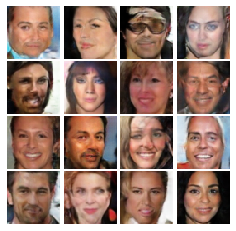


EPOCH:  16
Iter: 14800, D: 0.06503, G:0.6356


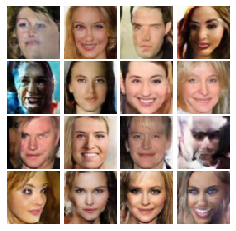


Iter: 15000, D: 0.0275, G:0.8857


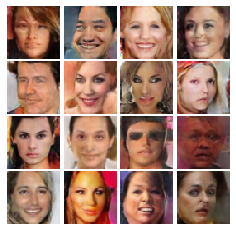


Iter: 15200, D: 0.159, G:1.387


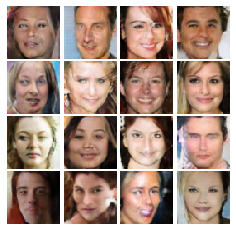


Iter: 15400, D: 0.1925, G:0.2456


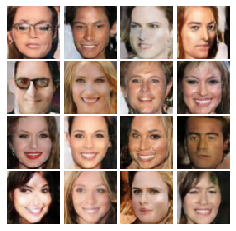


Iter: 15600, D: 0.0626, G:1.33


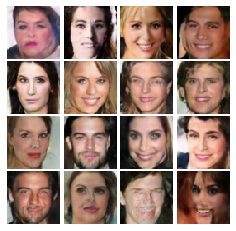


EPOCH:  17
Iter: 15800, D: 0.03292, G:0.6042


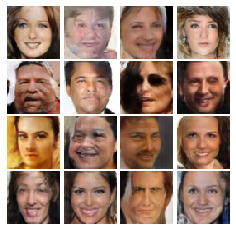


Iter: 16000, D: 0.06384, G:1.064


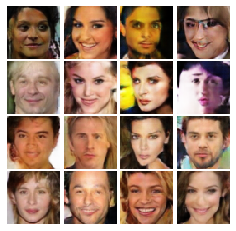


Iter: 16200, D: 0.06286, G:0.824


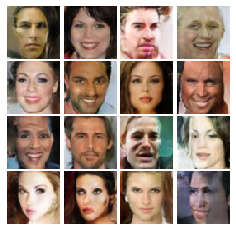


Iter: 16400, D: 0.1333, G:1.355


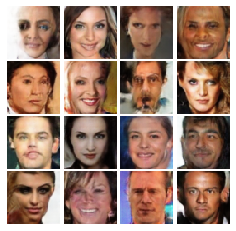


Iter: 16600, D: 0.05685, G:1.015


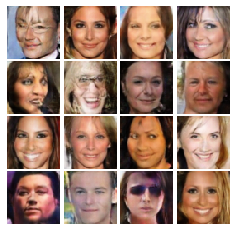


EPOCH:  18
Iter: 16800, D: 0.1002, G:0.685


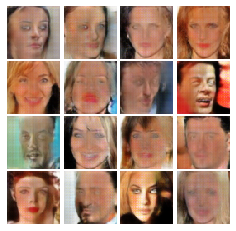


Iter: 17000, D: 0.2528, G:0.3136


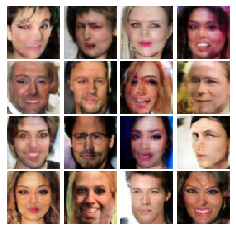


Iter: 17200, D: 0.2882, G:0.4755


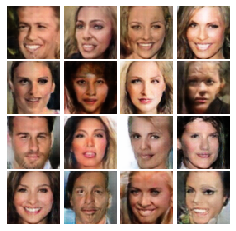


Iter: 17400, D: 0.2366, G:0.2842


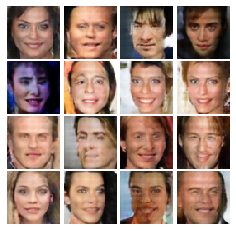


Iter: 17600, D: 0.2466, G:0.4763


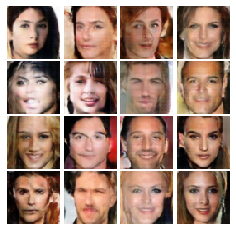


EPOCH:  19
Iter: 17800, D: 0.2245, G:0.3143


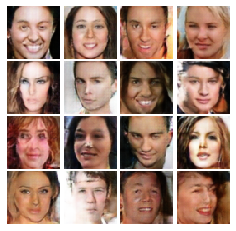


Iter: 18000, D: 0.301, G:0.2357


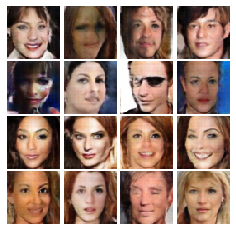


Iter: 18200, D: 0.2712, G:0.4926


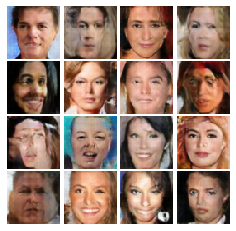


Iter: 18400, D: 0.2614, G:0.2833


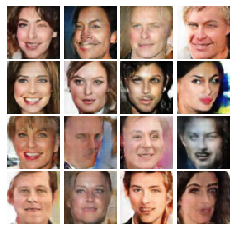


Iter: 18600, D: 0.1116, G:0.6933


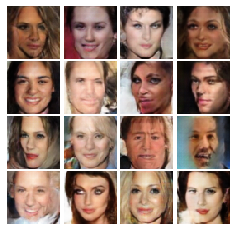


EPOCH:  20
Iter: 18800, D: 0.1315, G:0.6285


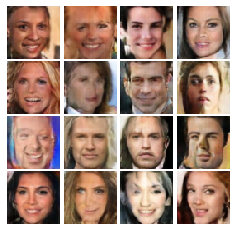


Iter: 19000, D: 0.03768, G:0.6771


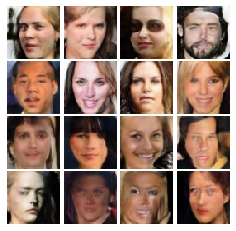


Iter: 19200, D: 0.06461, G:0.6987


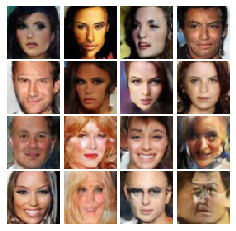


Iter: 19400, D: 0.07525, G:0.9587


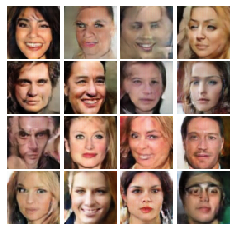


Iter: 19600, D: 0.05149, G:0.8441


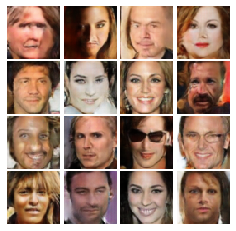

In [12]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=20, show_every=200,
          train_loader=celeba_loader_train, device=device)